In [ ]:
!pip install ultralytics opencv-python tensorflow keras scikit-learn matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 901.3/901.3 kB 28.1 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix, precision_score, recall_score, f1_score, accuracy_score
import matplotlib.pyplot as plt

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
from ultralytics import YOLO
import os

# Check if GPU is available
import torch
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

Using device: cuda


In [ ]:
# Step 1: Load YOLO11 Pretrained Model
model = YOLO("yolo11n.pt")  # Use 'yolo11s.pt', 'yolo11m.pt', etc., for larger models

100%|██████████| 5.35M/5.35M [00:00<00:00, 88.3MB/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import zipfile
zip_path =  '/content/drive/MyDrive/combine11.zip' # Replace with your ZIP file's path
extract_path = '/content/drive/My Drive/Folder/extracted'  # Replace with your desired extraction folder

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"ZIP file extracted to: {extract_path}")

ZIP file extracted to: /content/drive/My Drive/Folder/extracted


In [ ]:
# Path to your data.yaml file (modify if needed)
data_yaml_path = '/content/drive/MyDrive/Folder/extracted/combine11/data.yaml'

# Check if the file exists
if os.path.exists(data_yaml_path):
    print(f"Found dataset configuration: {data_yaml_path}")
else:
    raise FileNotFoundError("data.yaml file not found!")

Found dataset configuration: /content/drive/MyDrive/Folder/extracted/combine11/data.yaml


In [ ]:
# Load a pre-trained YOLO11 model (e.g., yolov8n.pt, yolov8s.pt, etc.)
model = YOLO('yolo11n.pt')  # 'yolo11n.pt' is the nano model; you can choose 's', 'm', 'l', 'x' for different sizes

# Training parameters
results = model.train(
    data=data_yaml_path,    # Path to your dataset YAML file
    epochs=10,              # Number of epochs for training
    batch=16,               # Batch size
    imgsz=640,              # Input image size
    device=device,          # Use CUDA if available
    project='yolov8_results',  # Project folder for saving results
    name='custom_training',   # Experiment name
    pretrained=True         # Use pretrained weights
)

Ultralytics 8.3.51 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/drive/MyDrive/Folder/extracted/combine11/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=yolov8_results, name=custom_training, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cro

100%|██████████| 755k/755k [00:00<00:00, 22.2MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/MyDrive/Folder/extracted/combine11/train/labels... 22181 images, 3 backgrounds, 0 corrupt: 100%|██████████| 22181/22181 [06:05<00:00, 60.71it/s]


train: New cache created: /content/drive/MyDrive/Folder/extracted/combine11/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.23 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/Folder/extracted/combine11/valid/labels... 2112 images, 2 backgrounds, 0 corrupt: 100%|██████████| 2112/2112 [00:43<00:00, 48.67it/s]


val: New cache created: /content/drive/MyDrive/Folder/extracted/combine11/valid/labels.cache
Plotting labels to yolov8_results/custom_training/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to yolov8_results/custom_training
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.51G     0.9921       1.58      1.191          7        640: 100%|██████████| 1387/1387 [10:53<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:38<00:00,  1.72it/s]


                   all       2112       3184      0.611      0.746      0.721       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.42G     0.8732      0.844      1.118          8        640: 100%|██████████| 1387/1387 [11:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:32<00:00,  2.05it/s]

                   all       2112       3184      0.687      0.636      0.726      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.42G     0.7994     0.7303      1.081          8        640: 100%|██████████| 1387/1387 [10:37<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:37<00:00,  1.76it/s]

                   all       2112       3184      0.768      0.777      0.817      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.41G     0.7241     0.6434       1.04          7        640: 100%|██████████| 1387/1387 [10:46<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:34<00:00,  1.90it/s]

                   all       2112       3184        0.8      0.824      0.866      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10       2.4G     0.6498      0.569      1.003          5        640: 100%|██████████| 1387/1387 [10:41<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:34<00:00,  1.89it/s]

                   all       2112       3184      0.876       0.88       0.93      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.42G     0.5931     0.5057     0.9751          6        640: 100%|██████████| 1387/1387 [10:31<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:34<00:00,  1.92it/s]


                   all       2112       3184      0.901      0.894       0.94      0.741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.41G     0.5506     0.4526     0.9527          7        640: 100%|██████████| 1387/1387 [10:27<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:38<00:00,  1.70it/s]

                   all       2112       3184      0.896      0.908      0.945       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.41G     0.5122     0.4141     0.9359          8        640: 100%|██████████| 1387/1387 [10:25<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:35<00:00,  1.86it/s]

                   all       2112       3184      0.914       0.91      0.955      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10       2.4G     0.4736     0.3759     0.9181          8        640: 100%|██████████| 1387/1387 [10:28<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:35<00:00,  1.85it/s]

                   all       2112       3184      0.903      0.937      0.962      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.42G     0.4402     0.3433     0.9039          5        640: 100%|██████████| 1387/1387 [10:30<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:33<00:00,  1.97it/s]

                   all       2112       3184       0.92      0.933      0.963      0.805



10 epochs completed in 1.881 hours.
Optimizer stripped from yolov8_results/custom_training/weights/last.pt, 5.5MB
Optimizer stripped from yolov8_results/custom_training/weights/best.pt, 5.5MB

Validating yolov8_results/custom_training/weights/best.pt...
Ultralytics 8.3.51 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:40<00:00,  1.64it/s]


                   all       2112       3184      0.922      0.931      0.963      0.805
           Empty Chair        808        896      0.948      0.959      0.984      0.797
                  Idle       1421       1614      0.947      0.942      0.974      0.834
               Working        669        674       0.87      0.893      0.931      0.784
Speed: 0.3ms preprocess, 2.7ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to yolov8_results/custom_training


In [ ]:
# Path to the trained weights (best.pt)
trained_weights = 'yolov8_results/custom_training/weights/best.pt'

# Load the trained model
model = YOLO(trained_weights)

# Evaluate the model on the validation set
metrics = model.val(
    data=data_yaml_path,  # Dataset YAML file
    imgsz=640,            # Image size
    batch=16,             # Batch size for evaluation
    device=device         # Device to use for evaluation
)

print("Evaluation completed!")
print(metrics)

Ultralytics 8.3.51 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/drive/MyDrive/Folder/extracted/combine11/valid/labels.cache... 2112 images, 2 backgrounds, 0 corrupt: 100%|██████████| 2112/2112 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 132/132 [01:01<00:00,  2.15it/s]


                   all       2112       3184       0.92      0.933      0.963      0.805
           Empty Chair        808        896      0.947      0.962      0.984      0.797
                  Idle       1421       1614      0.945      0.944      0.974      0.834
               Working        669        674      0.867      0.894      0.931      0.785
Speed: 0.4ms preprocess, 4.9ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to runs/detect/val
Evaluation completed!
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7921d1caca90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.0110



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1057 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1180_jpg.rf.bf4ea2c5329943e551c3359fe0a006c7.jpg: 640x640 1 Empty Chair, 1 Idle, 9.1ms
image 2/1057 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.rf.2a3cae49f94c6809816c14069c7e95e6.jpg: 640x640 1 Empty Chair, 1 Idle, 8.7ms
image 3/1057 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.

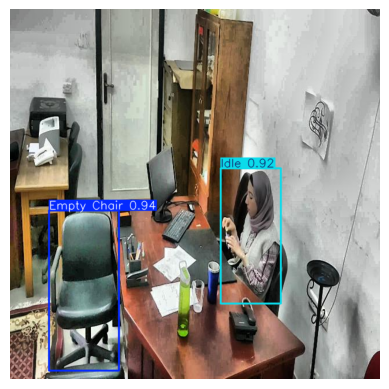

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Example image to test
test_image_path = '/content/drive/MyDrive/Folder/extracted/combine11/test/images'

# Load and predict
results = model(test_image_path)

# Display the results
result_image = results[0].plot()  # Plot the results on the image
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt


# Path to the test dataset
test_data_path = '/content/drive/MyDrive/Folder/extracted/combine11/data.yaml'  # Path to your test dataset YAML file

In [ ]:
import glob  # Import glob module
import matplotlib.pyplot as plt


image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1180_jpg.rf.bf4ea2c5329943e551c3359fe0a006c7.jpg: 640x640 1 Empty Chair, 1 Idle, 11.4ms
Speed: 2.7ms preprocess, 11.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


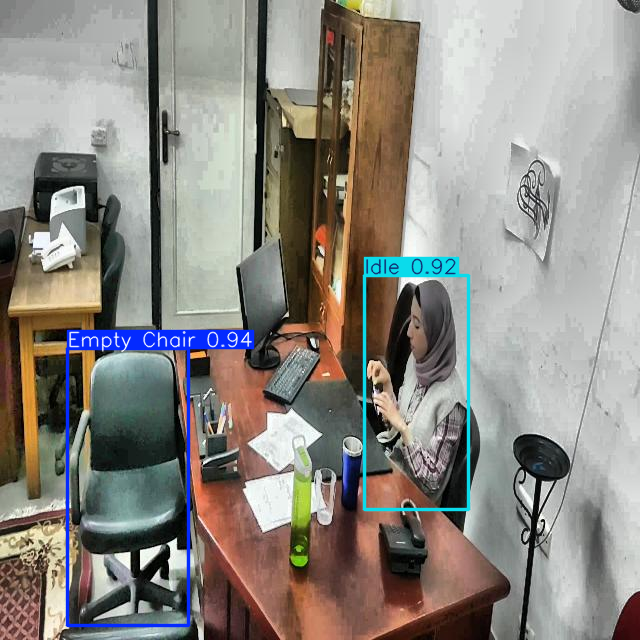

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1180_jpg.rf.bf4ea2c5329943e551c3359fe0a006c7_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.rf.2a3cae49f94c6809816c14069c7e95e6.jpg: 640x640 1 Empty Chair, 1 Idle, 17.4ms
Speed: 4.0ms preprocess, 17.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


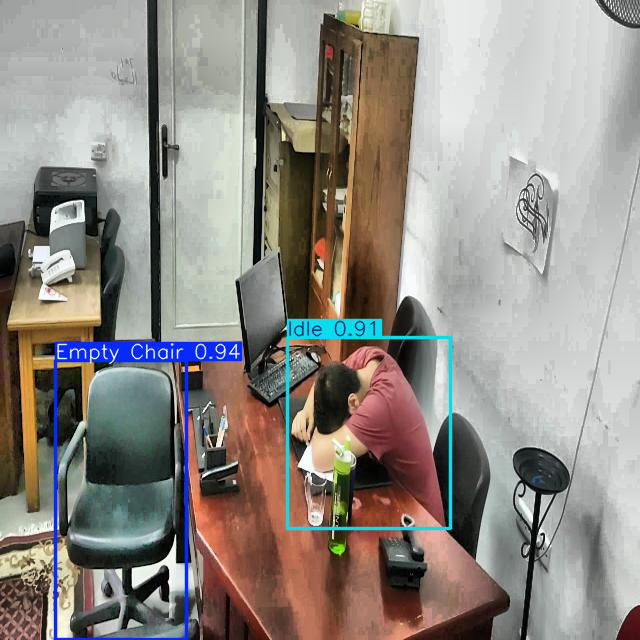

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.rf.2a3cae49f94c6809816c14069c7e95e6_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.rf.5072c44664baf133f51966ca43a9a77f.jpg: 640x640 1 Empty Chair, 1 Idle, 13.0ms
Speed: 2.1ms preprocess, 13.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


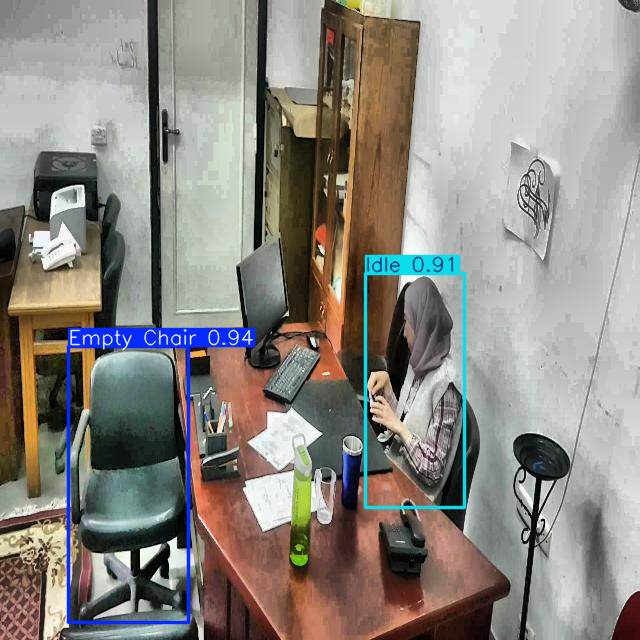

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1240_jpg.rf.5072c44664baf133f51966ca43a9a77f_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1380_jpg.rf.6d894deef3162fb4fc03c2d356bc1546.jpg: 640x640 1 Empty Chair, 1 Idle, 13.4ms
Speed: 2.4ms preprocess, 13.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


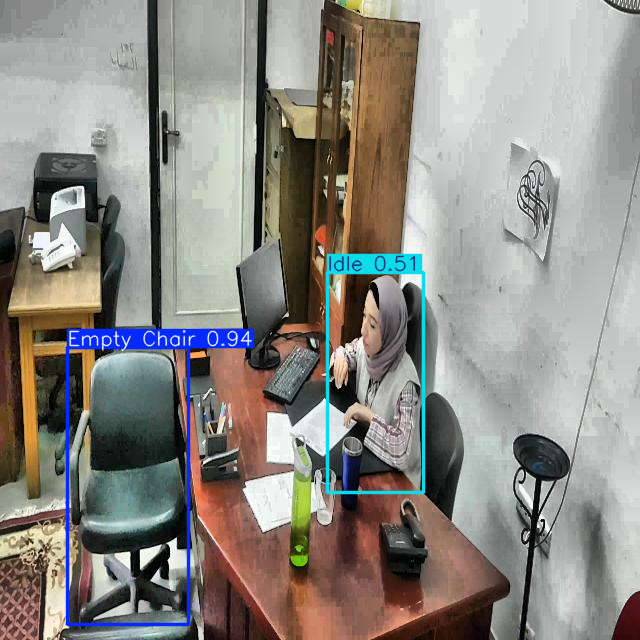

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1380_jpg.rf.6d894deef3162fb4fc03c2d356bc1546_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1440_jpg.rf.d9b16ea0d888cd0f4587c332b803e4e5.jpg: 640x640 1 Empty Chair, 1 Idle, 19.3ms
Speed: 3.4ms preprocess, 19.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


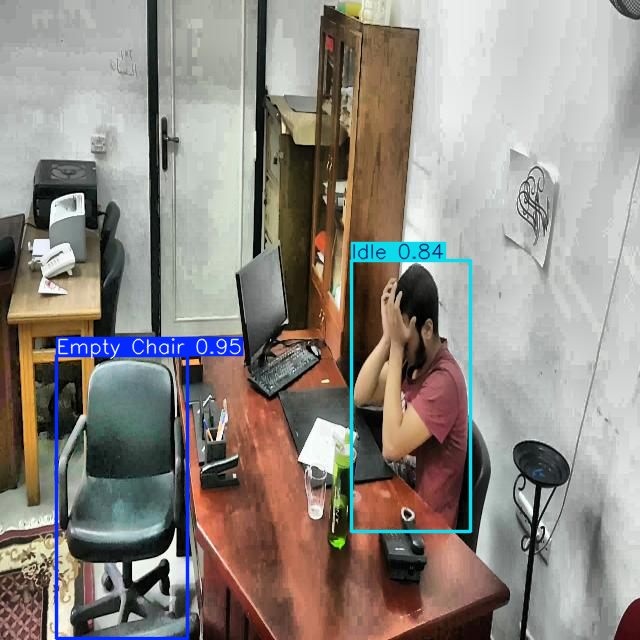

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1440_jpg.rf.d9b16ea0d888cd0f4587c332b803e4e5_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1480_jpg.rf.081ae25569f8e473ce5d03c621461ac5.jpg: 640x640 1 Empty Chair, 1 Idle, 1 Working, 20.2ms
Speed: 2.5ms preprocess, 20.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


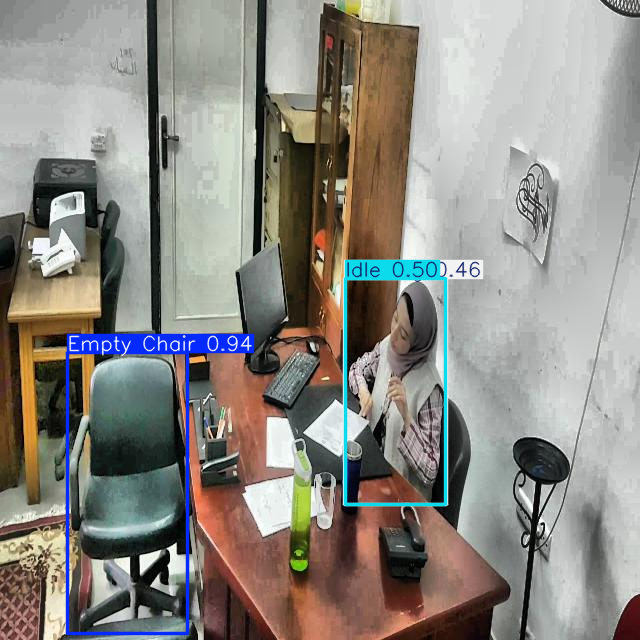

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1480_jpg.rf.081ae25569f8e473ce5d03c621461ac5_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1540_jpg.rf.f53d11b35e4f96f2a50cec2846268b73.jpg: 640x640 1 Empty Chair, 1 Working, 21.2ms
Speed: 2.5ms preprocess, 21.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


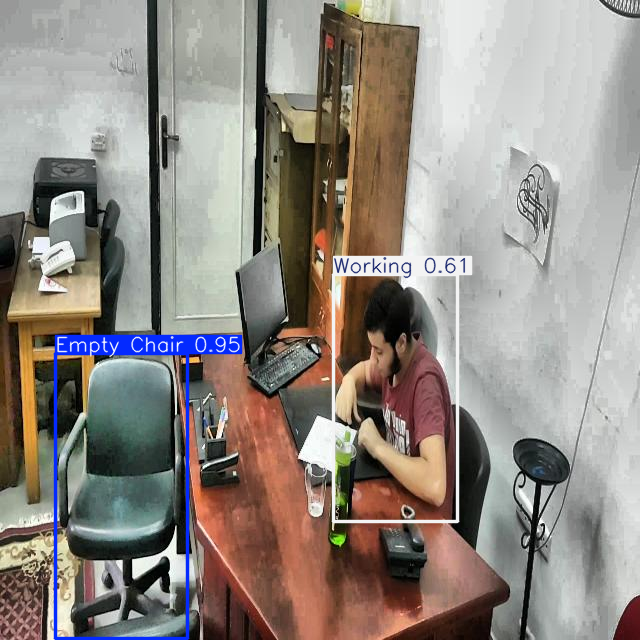

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1540_jpg.rf.f53d11b35e4f96f2a50cec2846268b73_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1560_jpg.rf.8248353324128766ce6ae4ff1de16c90.jpg: 640x640 1 Empty Chair, 1 Idle, 14.2ms
Speed: 2.2ms preprocess, 14.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


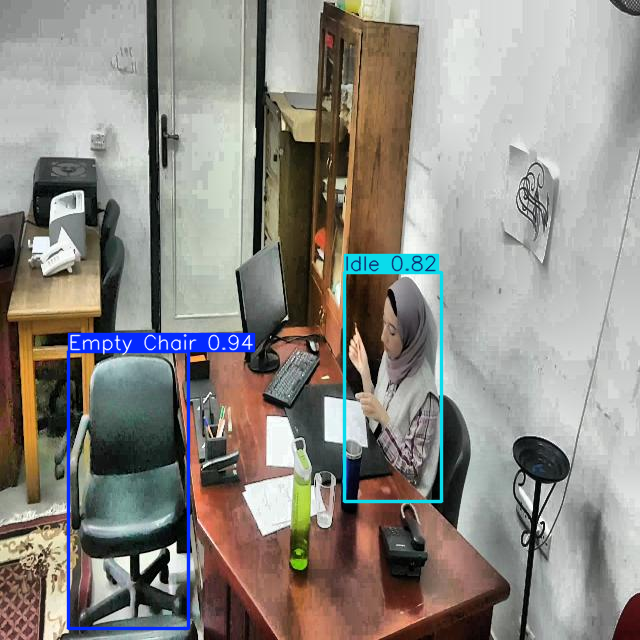

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1560_jpg.rf.8248353324128766ce6ae4ff1de16c90_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1680_jpg.rf.27410a54b47dfaecc397806029dcf59a.jpg: 640x640 1 Empty Chair, 1 Working, 45.0ms
Speed: 4.9ms preprocess, 45.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


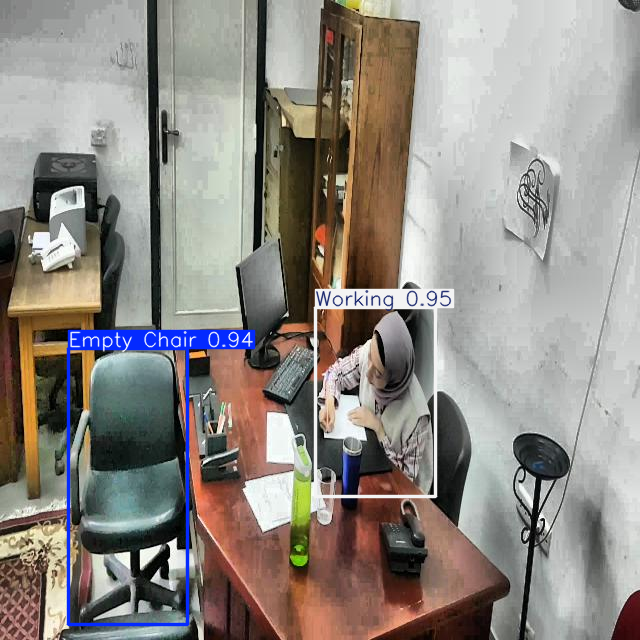

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1680_jpg.rf.27410a54b47dfaecc397806029dcf59a_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1760_jpg.rf.001253bf7ca63c2eb200ea52489b139b.jpg: 640x640 1 Empty Chair, 1 Working, 15.8ms
Speed: 4.4ms preprocess, 15.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


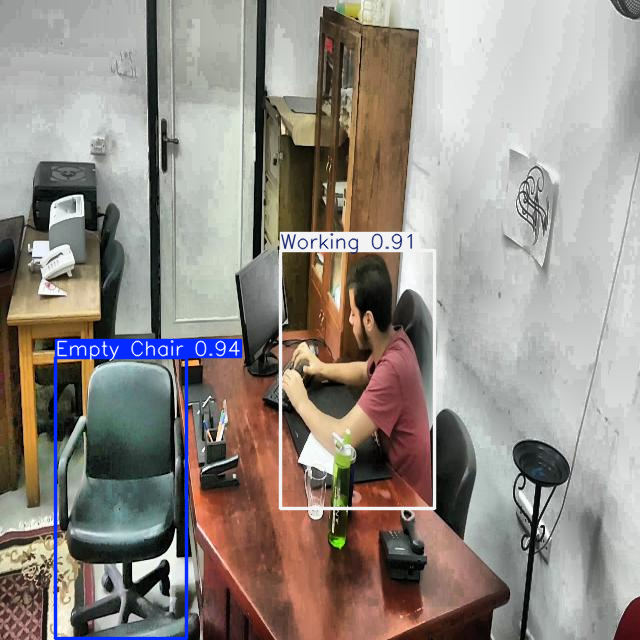

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1760_jpg.rf.001253bf7ca63c2eb200ea52489b139b_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1780_jpg.rf.1dcb88c9a807ac53f8cc58abceebea3c.jpg: 640x640 1 Empty Chair, 1 Working, 62.4ms
Speed: 2.6ms preprocess, 62.4ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


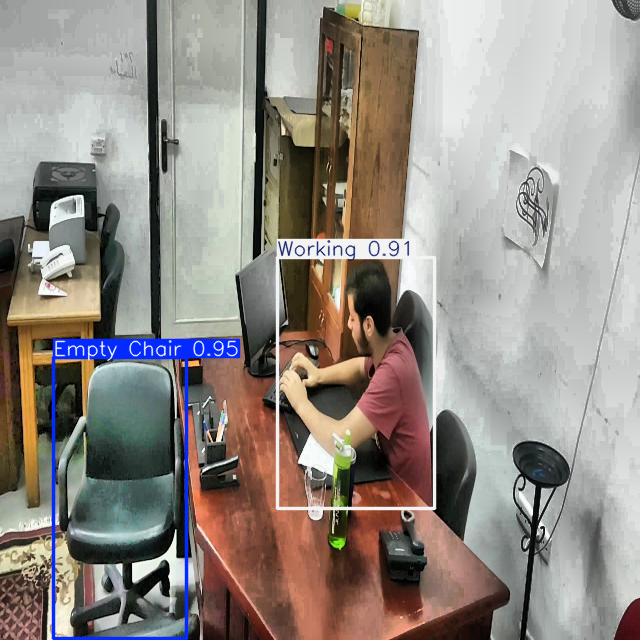

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1780_jpg.rf.1dcb88c9a807ac53f8cc58abceebea3c_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1780_jpg.rf.ae4245b1d239a3324c4ab57b4436e53f.jpg: 640x640 1 Empty Chair, 1 Working, 13.6ms
Speed: 2.5ms preprocess, 13.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


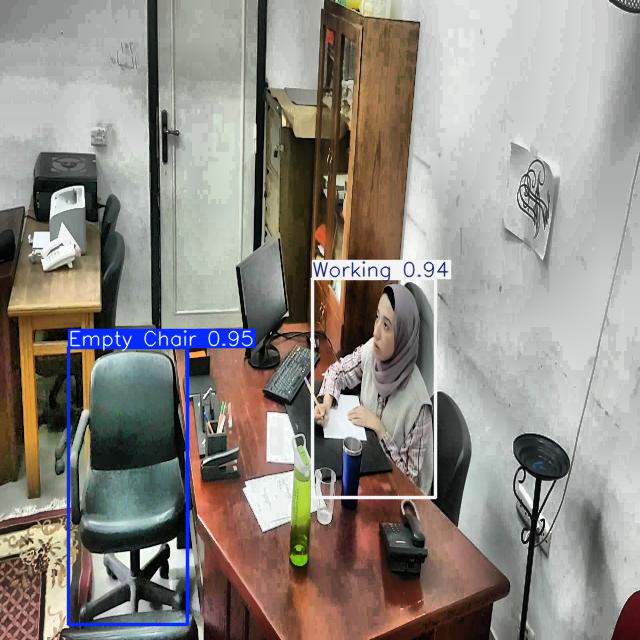

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1780_jpg.rf.ae4245b1d239a3324c4ab57b4436e53f_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1820_jpg.rf.36e7f6350d4f88c950a6c07987c0af39.jpg: 640x640 1 Empty Chair, 1 Working, 20.2ms
Speed: 2.1ms preprocess, 20.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


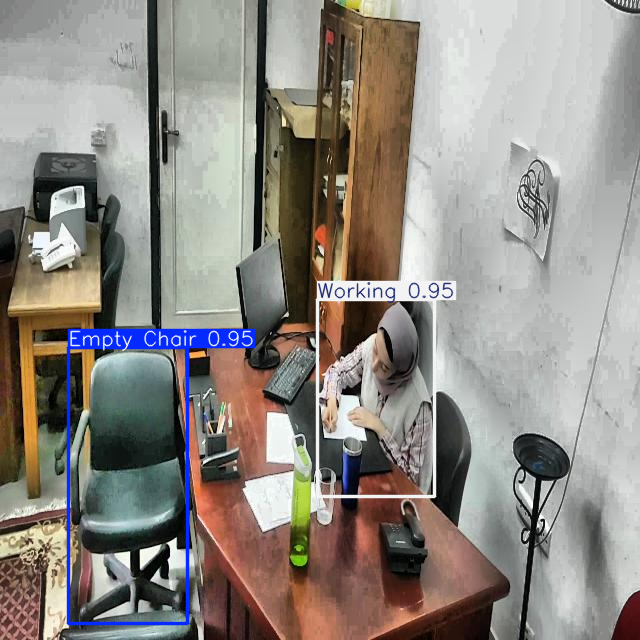

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1820_jpg.rf.36e7f6350d4f88c950a6c07987c0af39_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1840_jpg.rf.10c4a363cf26b9516b1cb4ab644f80da.jpg: 640x640 1 Empty Chair, 1 Working, 15.9ms
Speed: 6.5ms preprocess, 15.9ms inference, 4.9ms postprocess per image at shape (1, 3, 640, 640)


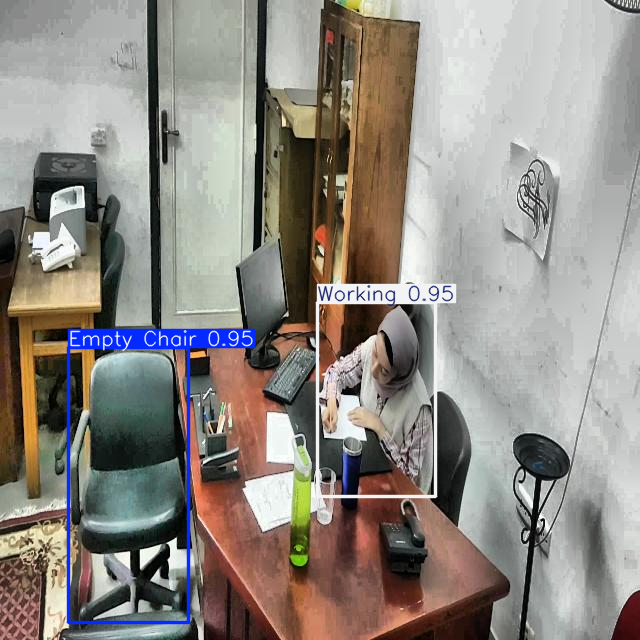

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1840_jpg.rf.10c4a363cf26b9516b1cb4ab644f80da_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1860_jpg.rf.ef32b9c3405dcde7a711ef954af7e1db.jpg: 640x640 1 Empty Chair, 1 Working, 21.6ms
Speed: 2.1ms preprocess, 21.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


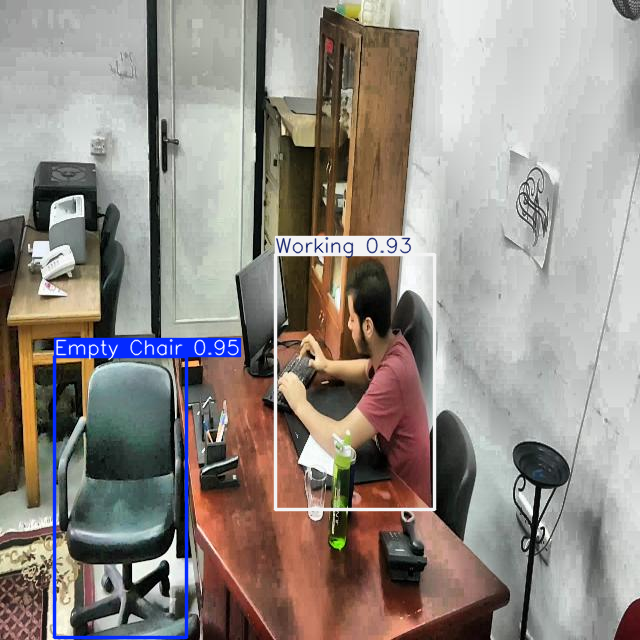

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1860_jpg.rf.ef32b9c3405dcde7a711ef954af7e1db_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1920_jpg.rf.69fea3170906a45c83dc7f039efc62c3.jpg: 640x640 1 Empty Chair, 1 Working, 20.5ms
Speed: 2.2ms preprocess, 20.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


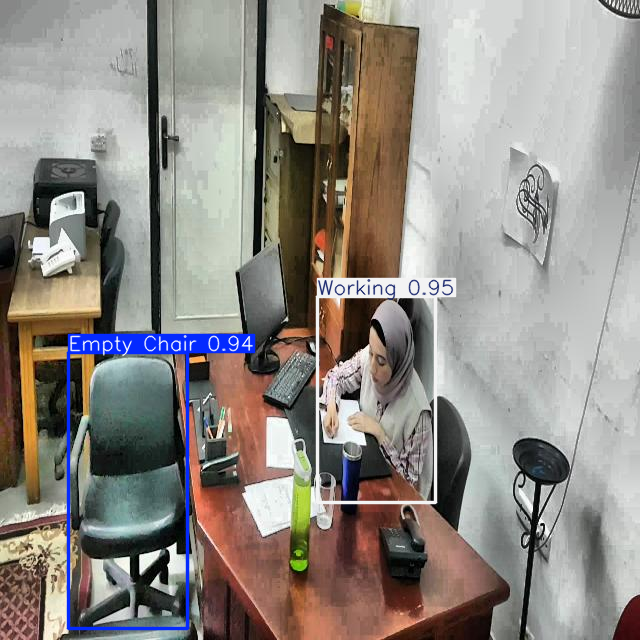

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1920_jpg.rf.69fea3170906a45c83dc7f039efc62c3_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1940_jpg.rf.9bc095d3182826f11519707026c29ba4.jpg: 640x640 1 Empty Chair, 1 Working, 23.5ms
Speed: 2.3ms preprocess, 23.5ms inference, 6.7ms postprocess per image at shape (1, 3, 640, 640)


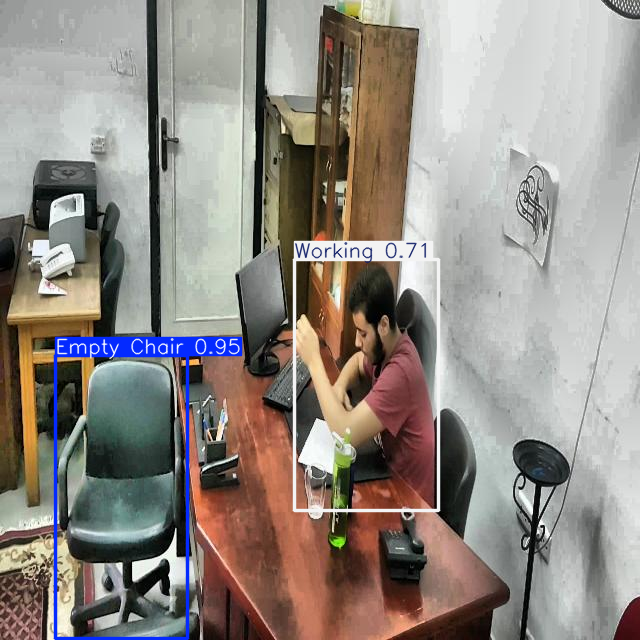

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1940_jpg.rf.9bc095d3182826f11519707026c29ba4_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1960_jpg.rf.b96862ef678d242fbfed4945ed3c34e8.jpg: 640x640 1 Empty Chair, 1 Working, 20.7ms
Speed: 2.4ms preprocess, 20.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


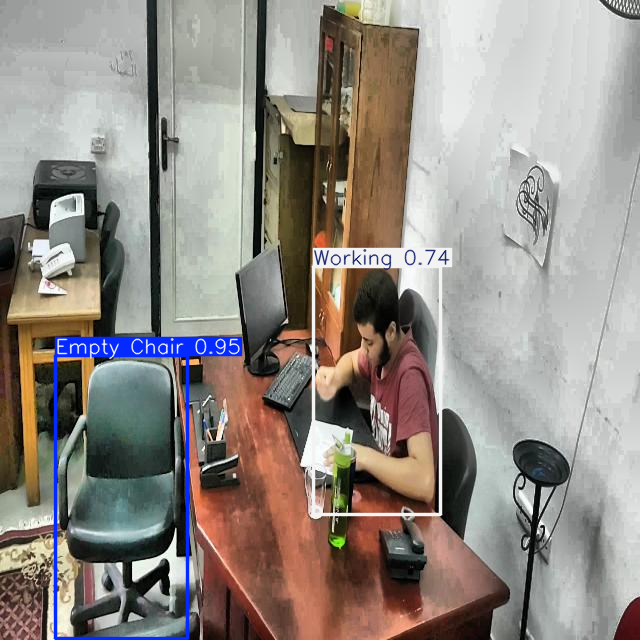

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame1960_jpg.rf.b96862ef678d242fbfed4945ed3c34e8_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2000_jpg.rf.4def58eba41bbd4f344cb77d14559634.jpg: 640x640 1 Empty Chair, 1 Working, 22.5ms
Speed: 2.3ms preprocess, 22.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


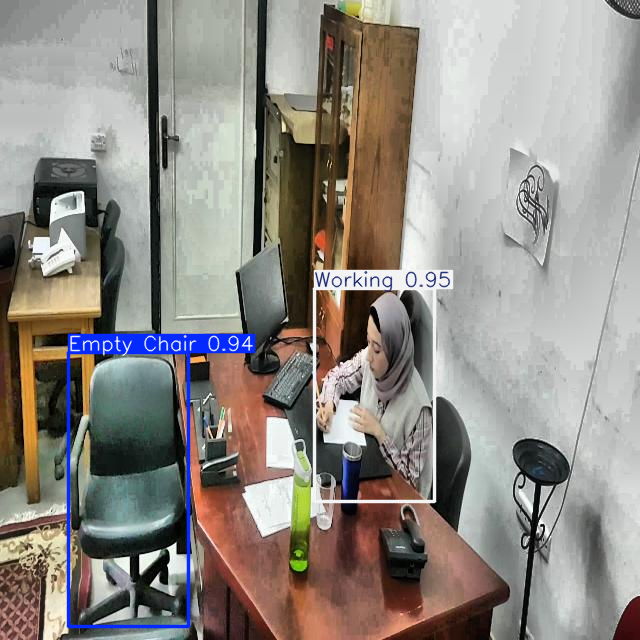

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2000_jpg.rf.4def58eba41bbd4f344cb77d14559634_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2020_jpg.rf.ab77afbe45131d70a08059d02cc4822a.jpg: 640x640 1 Empty Chair, 1 Working, 19.7ms
Speed: 2.4ms preprocess, 19.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


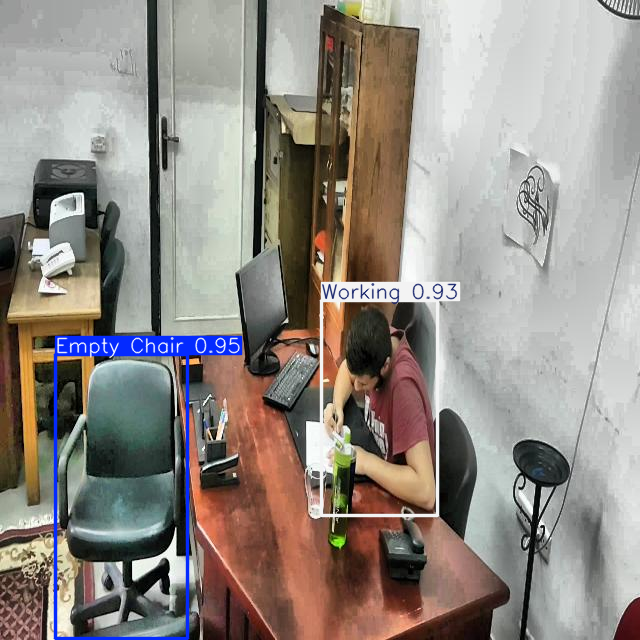

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2020_jpg.rf.ab77afbe45131d70a08059d02cc4822a_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2120_jpg.rf.7dd450f20d3bbee5e1372869288a7031.jpg: 640x640 1 Empty Chair, 1 Working, 21.3ms
Speed: 3.1ms preprocess, 21.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


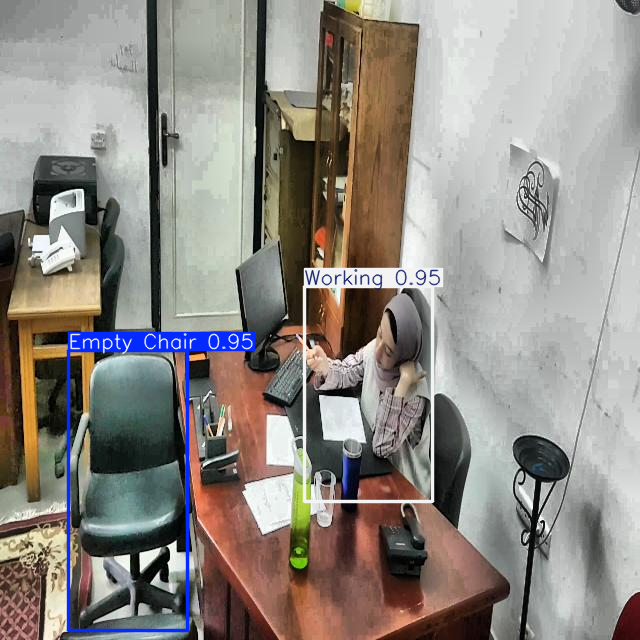

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2120_jpg.rf.7dd450f20d3bbee5e1372869288a7031_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2200_jpg.rf.0aa17972b0fc2448248f12c8187054e0.jpg: 640x640 1 Empty Chair, 1 Working, 25.1ms
Speed: 3.1ms preprocess, 25.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


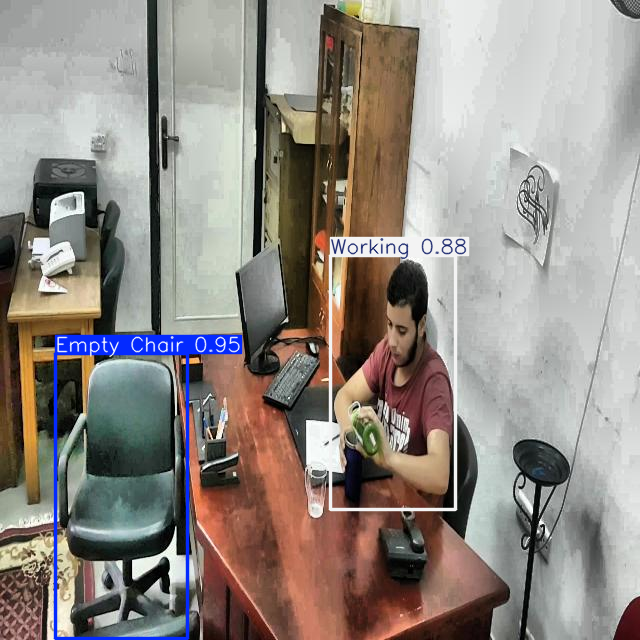

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2200_jpg.rf.0aa17972b0fc2448248f12c8187054e0_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2300_jpg.rf.9a8b01c2d42aa3523893d7b13c6ba61e.jpg: 640x640 1 Empty Chair, 1 Working, 24.8ms
Speed: 2.3ms preprocess, 24.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


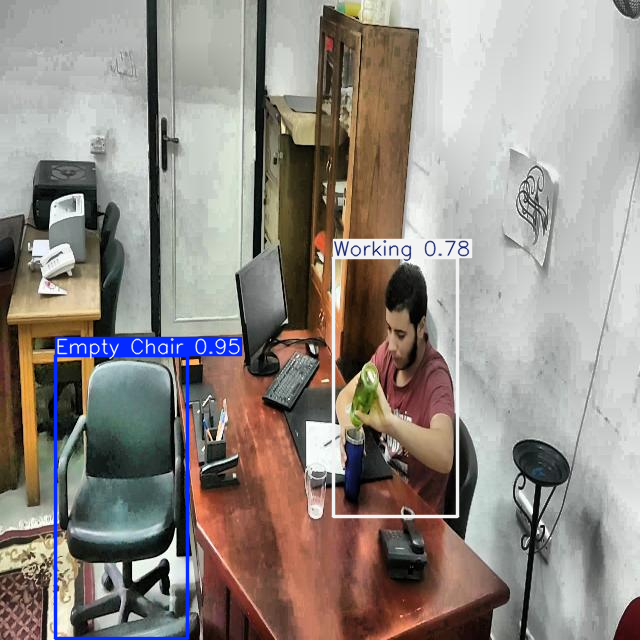

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2300_jpg.rf.9a8b01c2d42aa3523893d7b13c6ba61e_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2360_jpg.rf.217d73f78869ed01ee0a8f27baeed18e.jpg: 640x640 1 Empty Chair, 1 Idle, 28.0ms
Speed: 2.1ms preprocess, 28.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


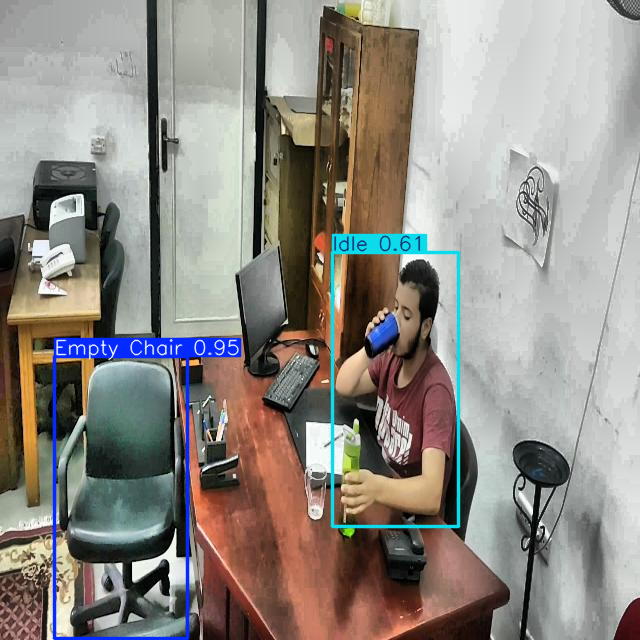

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2360_jpg.rf.217d73f78869ed01ee0a8f27baeed18e_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2380_jpg.rf.ec662ab02e082319d8ff49b66d2bb2f6.jpg: 640x640 1 Empty Chair, 1 Idle, 24.3ms
Speed: 2.3ms preprocess, 24.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


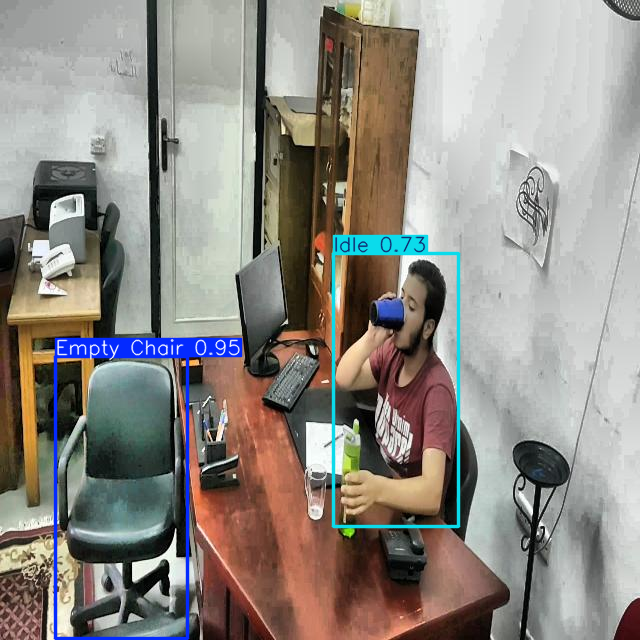

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2380_jpg.rf.ec662ab02e082319d8ff49b66d2bb2f6_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame260_jpg.rf.e9be34cab744420d2aacb63ffbf4da68.jpg: 640x640 3 Empty Chairs, 1 Idle, 16.9ms
Speed: 2.2ms preprocess, 16.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


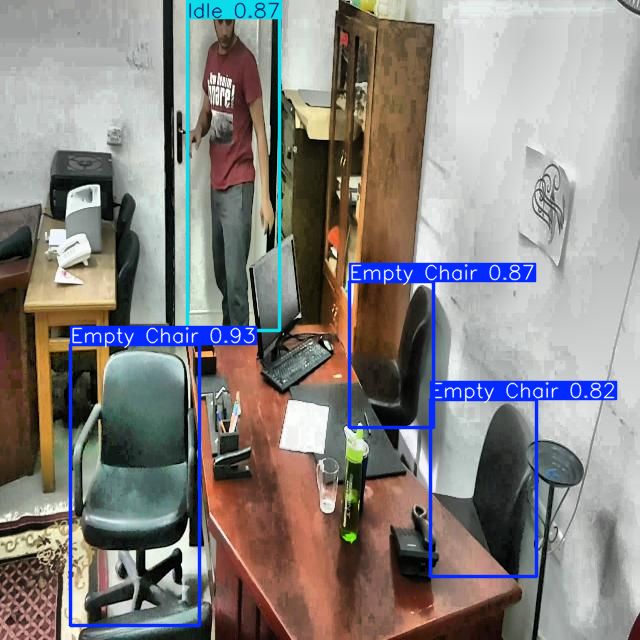

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame260_jpg.rf.e9be34cab744420d2aacb63ffbf4da68_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2660_jpg.rf.33e22ac430af4b794f307289c141ad0d.jpg: 640x640 1 Empty Chair, 1 Working, 13.4ms
Speed: 2.1ms preprocess, 13.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


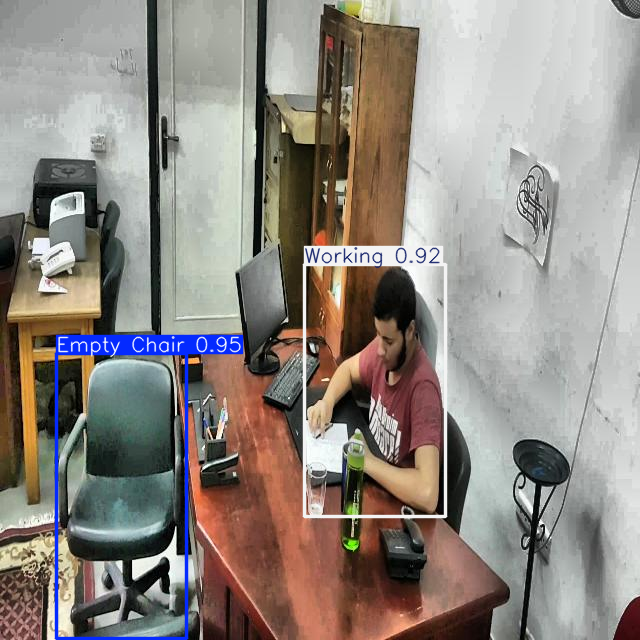

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2660_jpg.rf.33e22ac430af4b794f307289c141ad0d_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2740_jpg.rf.c9cc4e178e3373feae278c808e43aa95.jpg: 640x640 1 Empty Chair, 1 Idle, 18.0ms
Speed: 2.1ms preprocess, 18.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


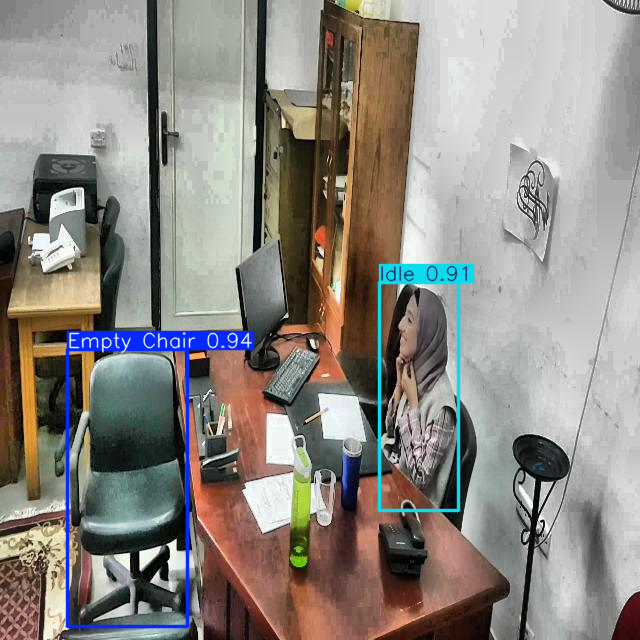

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2740_jpg.rf.c9cc4e178e3373feae278c808e43aa95_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2780_jpg.rf.d710227e415c29db7201f13b5f02fbc5.jpg: 640x640 1 Empty Chair, 1 Idle, 16.3ms
Speed: 2.1ms preprocess, 16.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


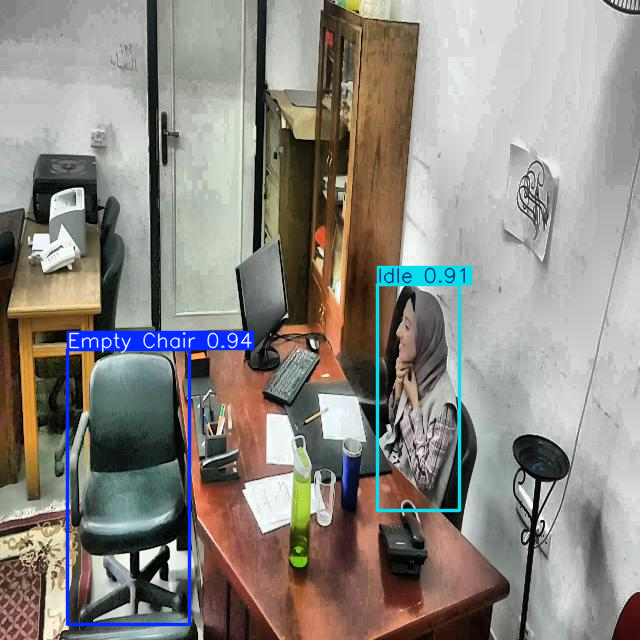

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame2780_jpg.rf.d710227e415c29db7201f13b5f02fbc5_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3300_jpg.rf.6d0b63035f123ab1180be31aa45580f2.jpg: 640x640 1 Empty Chair, 1 Working, 17.1ms
Speed: 2.1ms preprocess, 17.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


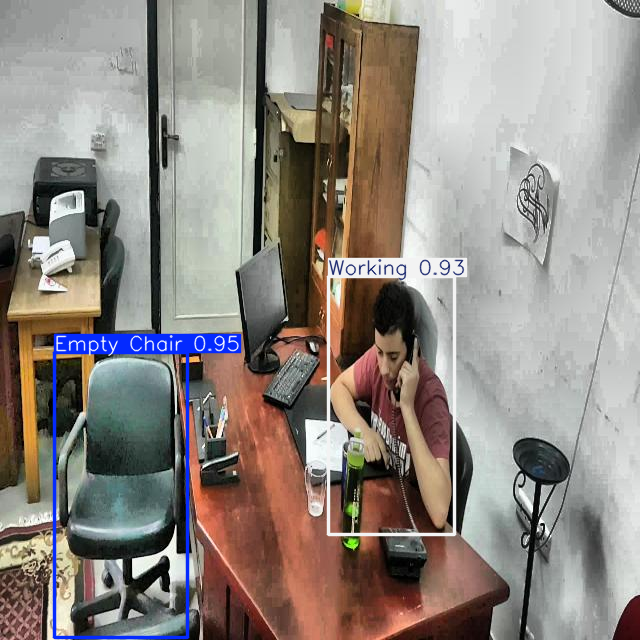

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3300_jpg.rf.6d0b63035f123ab1180be31aa45580f2_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3580_jpg.rf.f0651c30f2d5c9470676d6bf4cbbad04.jpg: 640x640 1 Empty Chair, 1 Idle, 13.4ms
Speed: 2.1ms preprocess, 13.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


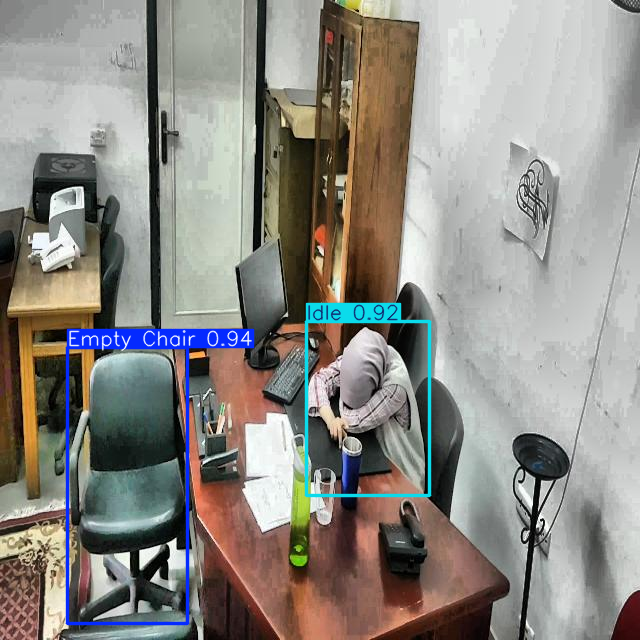

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3580_jpg.rf.f0651c30f2d5c9470676d6bf4cbbad04_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3800_jpg.rf.df482f7af7064c5ce1b1687ecaa06f74.jpg: 640x640 2 Idles, 20.6ms
Speed: 2.3ms preprocess, 20.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


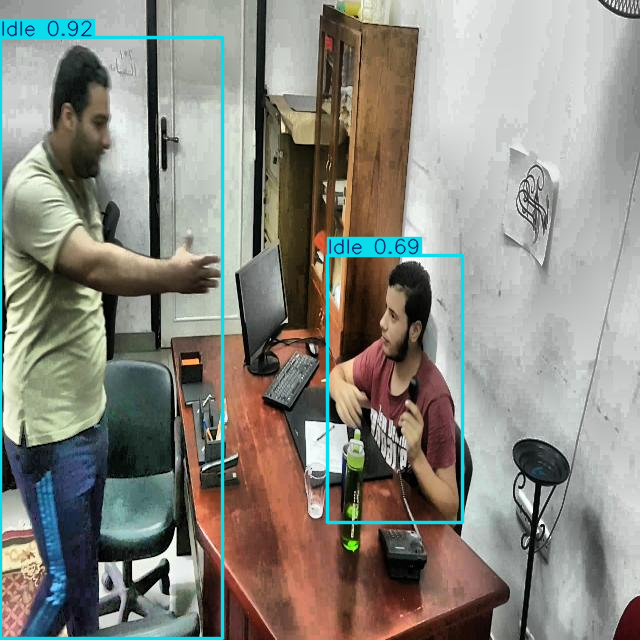

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3800_jpg.rf.df482f7af7064c5ce1b1687ecaa06f74_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3900_jpg.rf.fce6cee993c98f0e3486cc97a24acca8.jpg: 640x640 2 Idles, 20.4ms
Speed: 2.3ms preprocess, 20.4ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


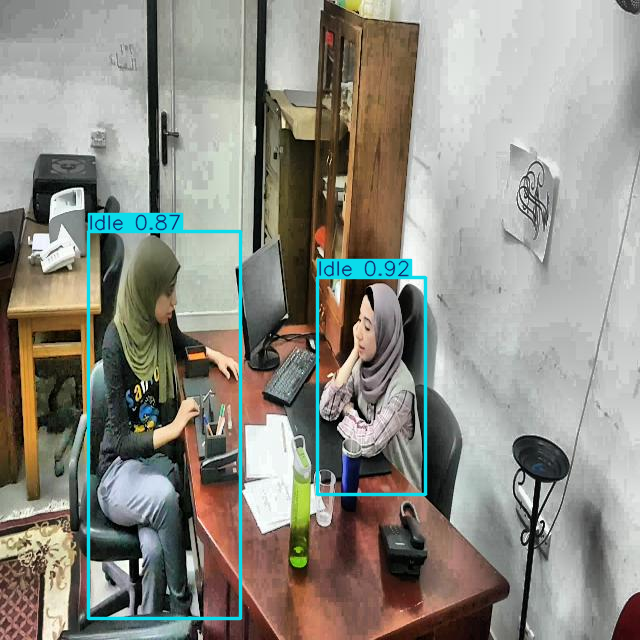

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame3900_jpg.rf.fce6cee993c98f0e3486cc97a24acca8_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4020_jpg.rf.1b862d47092e358413aa3b1c1712f3d6.jpg: 640x640 1 Idle, 1 Working, 19.0ms
Speed: 2.1ms preprocess, 19.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


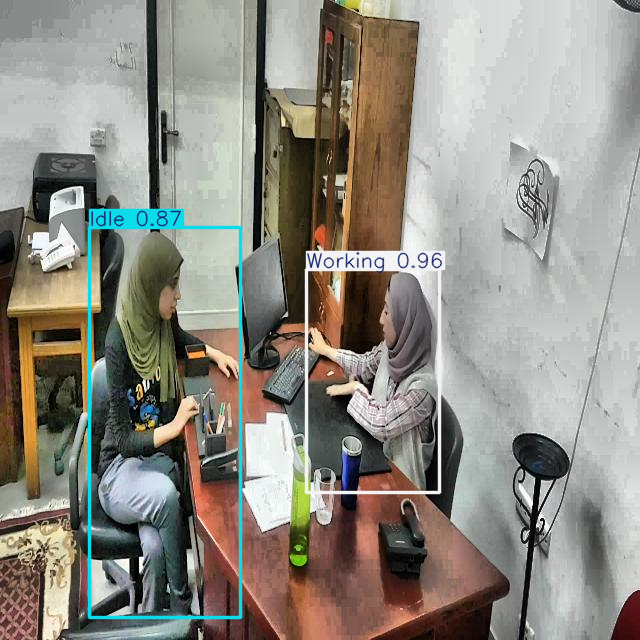

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4020_jpg.rf.1b862d47092e358413aa3b1c1712f3d6_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4060_jpg.rf.4f3f06ea13ebf6cd5f5ae5b0e814abb3.jpg: 640x640 2 Idles, 21.0ms
Speed: 2.3ms preprocess, 21.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


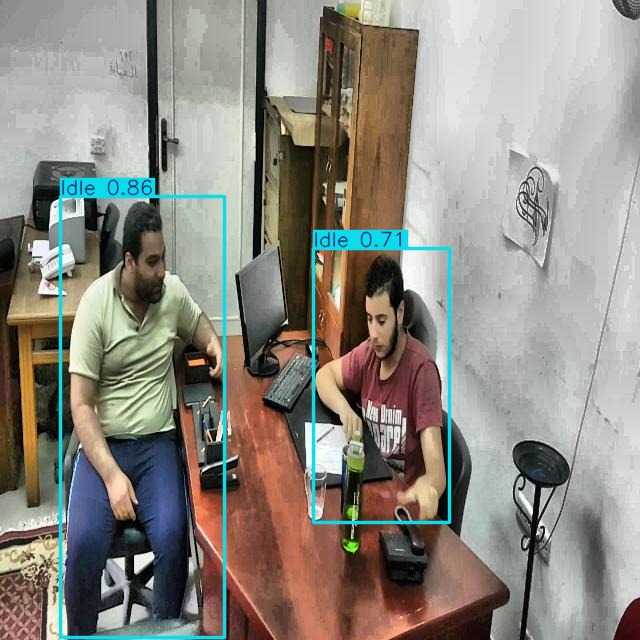

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4060_jpg.rf.4f3f06ea13ebf6cd5f5ae5b0e814abb3_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4100_jpg.rf.5cb0103854754b5fb78e5bb99efafb09.jpg: 640x640 1 Idle, 1 Working, 17.0ms
Speed: 2.1ms preprocess, 17.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


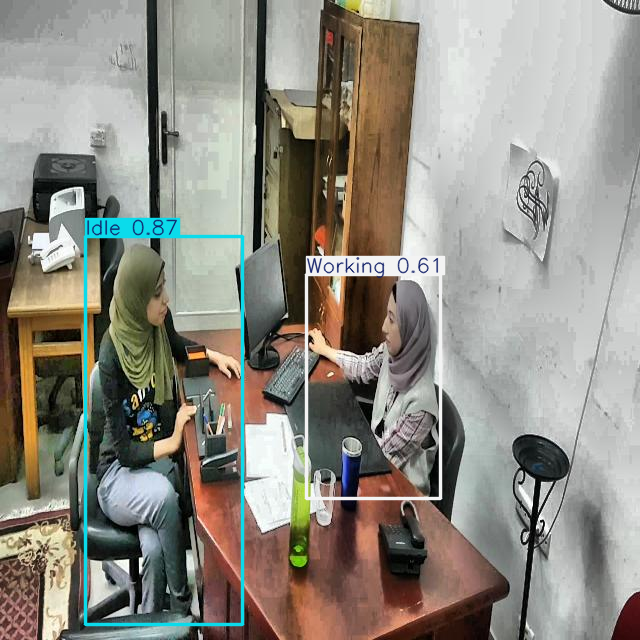

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4100_jpg.rf.5cb0103854754b5fb78e5bb99efafb09_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4160_jpg.rf.6dd698abc6d21ac4dc9c654906dbb756.jpg: 640x640 2 Idles, 15.7ms
Speed: 2.1ms preprocess, 15.7ms inference, 4.2ms postprocess per image at shape (1, 3, 640, 640)


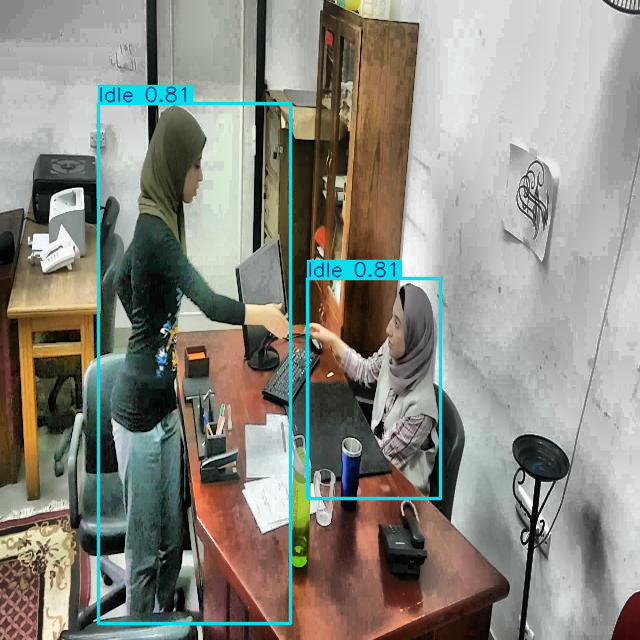

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4160_jpg.rf.6dd698abc6d21ac4dc9c654906dbb756_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4260_jpg.rf.04d3fb5ffd73abf9436ea36fa2d0b0d7.jpg: 640x640 1 Empty Chair, 1 Working, 20.0ms
Speed: 1.9ms preprocess, 20.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


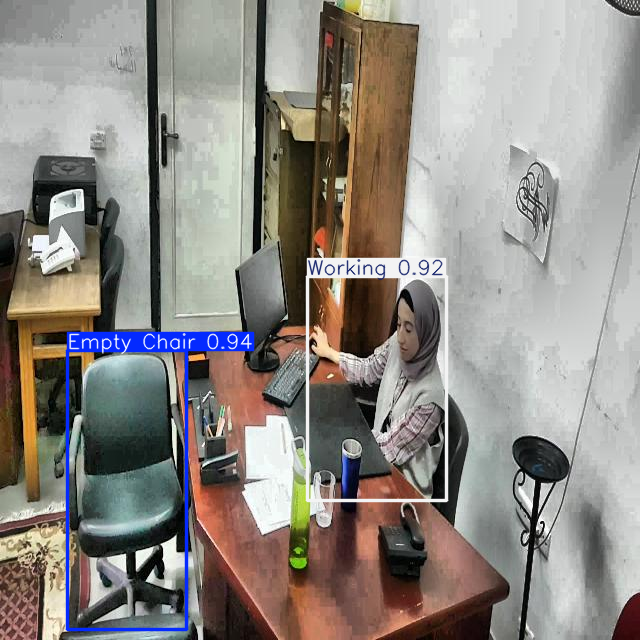

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4260_jpg.rf.04d3fb5ffd73abf9436ea36fa2d0b0d7_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4380_jpg.rf.09c016726ed9188016d81d3b0d39a028.jpg: 640x640 1 Empty Chair, 1 Working, 18.2ms
Speed: 2.1ms preprocess, 18.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


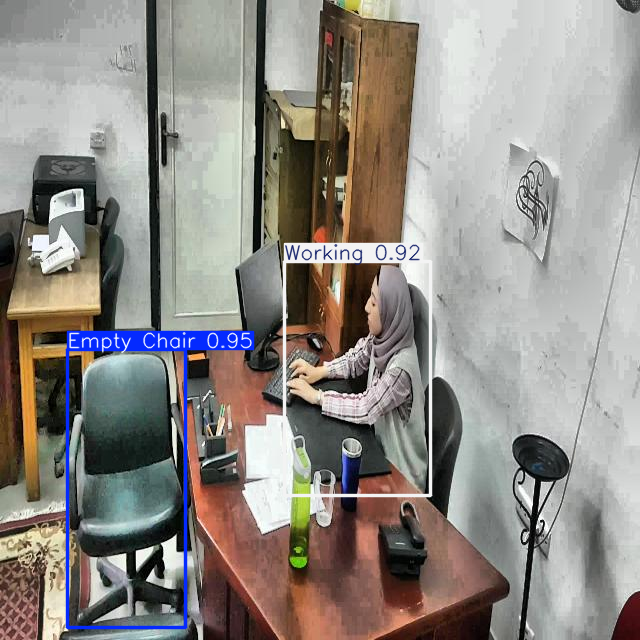

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4380_jpg.rf.09c016726ed9188016d81d3b0d39a028_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4480_jpg.rf.cabea60f2fee8558f1d95695de37d504.jpg: 640x640 1 Empty Chair, 1 Working, 13.2ms
Speed: 2.1ms preprocess, 13.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


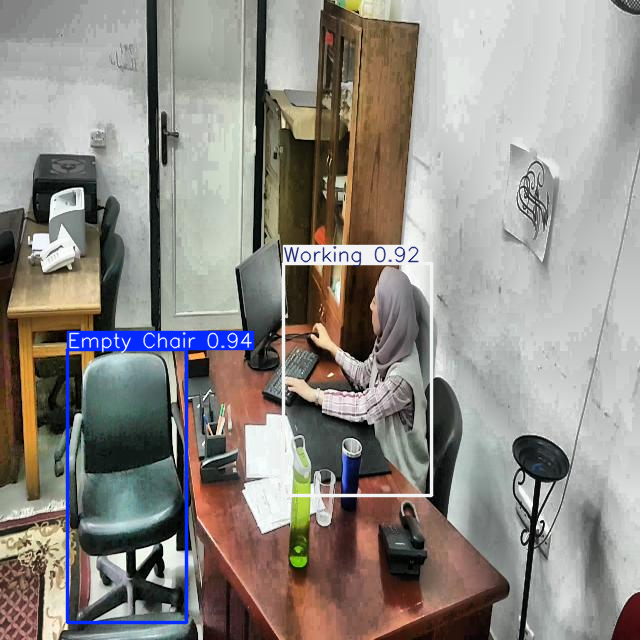

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4480_jpg.rf.cabea60f2fee8558f1d95695de37d504_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4600_jpg.rf.2e489fbf301a5210dfd8469836702be6.jpg: 640x640 2 Idles, 15.9ms
Speed: 2.5ms preprocess, 15.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


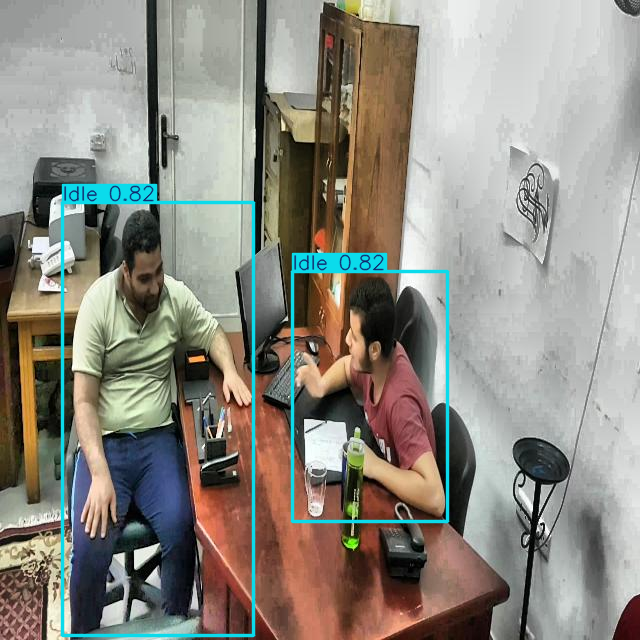

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4600_jpg.rf.2e489fbf301a5210dfd8469836702be6_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4780_jpg.rf.8b7805fd5549142f37a49a721d76431b.jpg: 640x640 1 Empty Chair, 1 Working, 14.9ms
Speed: 2.3ms preprocess, 14.9ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 640)


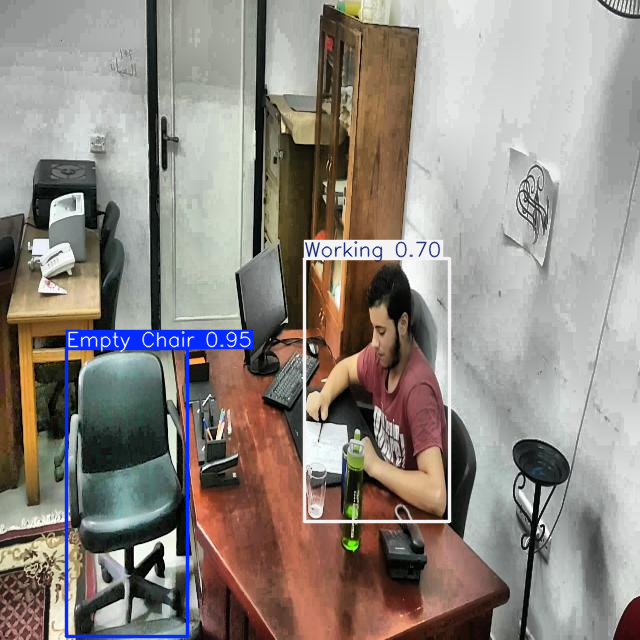

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame4780_jpg.rf.8b7805fd5549142f37a49a721d76431b_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame480_jpg.rf.deea73876d3f55650522337735a6b05e.jpg: 640x640 1 Empty Chair, 1 Idle, 16.9ms
Speed: 2.2ms preprocess, 16.9ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


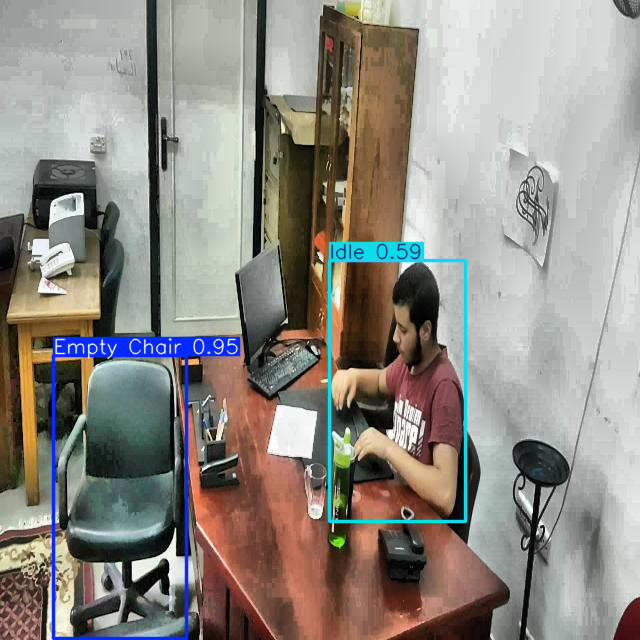

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame480_jpg.rf.deea73876d3f55650522337735a6b05e_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5060_jpg.rf.090cdb2965f888b5a641905be9622450.jpg: 640x640 2 Empty Chairs, 1 Idle, 15.8ms
Speed: 2.3ms preprocess, 15.8ms inference, 4.8ms postprocess per image at shape (1, 3, 640, 640)


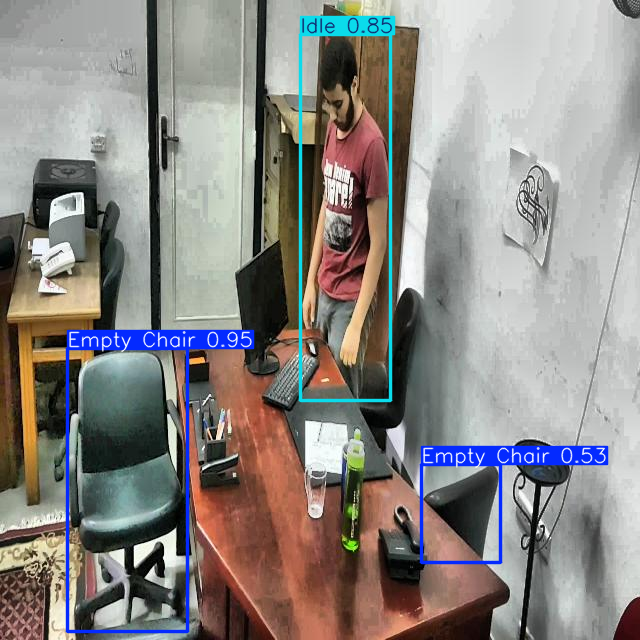

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5060_jpg.rf.090cdb2965f888b5a641905be9622450_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5160_jpg.rf.286cc584ef81a588d6a2b7baa9477e5a.jpg: 640x640 2 Empty Chairs, 1 Idle, 15.9ms
Speed: 2.1ms preprocess, 15.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


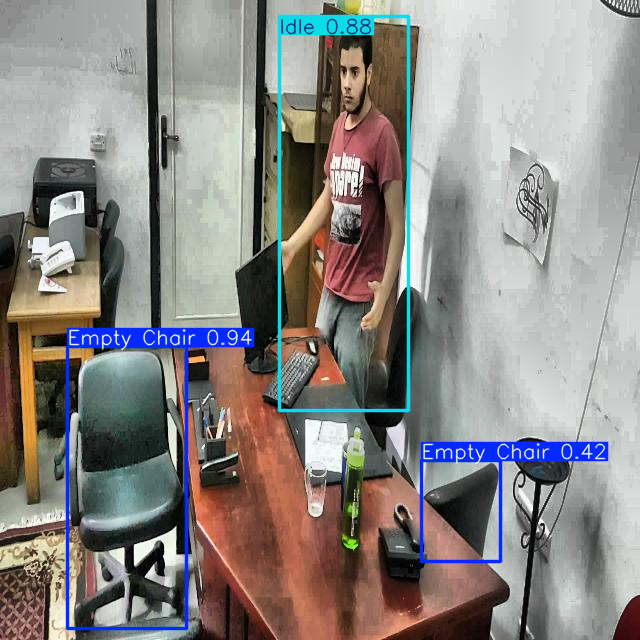

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5160_jpg.rf.286cc584ef81a588d6a2b7baa9477e5a_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5180_jpg.rf.02f4a4bf96ab7ab405271b34a85401a0.jpg: 640x640 1 Empty Chair, 1 Idle, 17.3ms
Speed: 2.1ms preprocess, 17.3ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


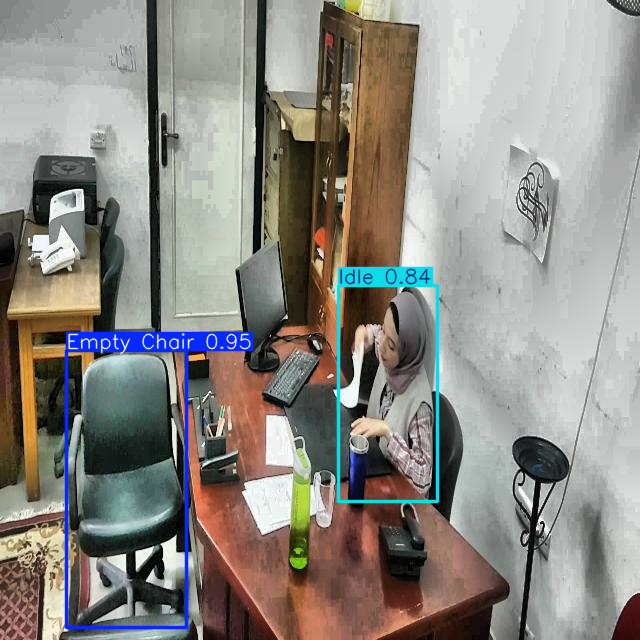

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5180_jpg.rf.02f4a4bf96ab7ab405271b34a85401a0_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5220_jpg.rf.a781e4caaeaf41a1d053ff9d5fa368d7.jpg: 640x640 2 Empty Chairs, 1 Idle, 18.3ms
Speed: 2.4ms preprocess, 18.3ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


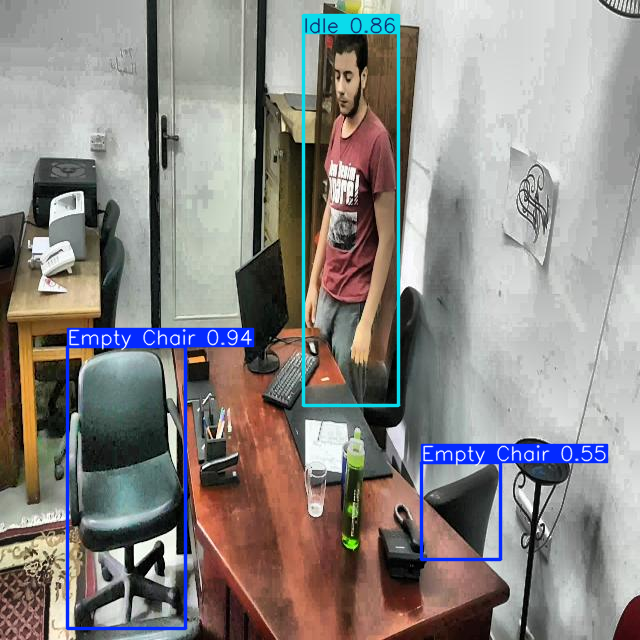

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5220_jpg.rf.a781e4caaeaf41a1d053ff9d5fa368d7_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5380_jpg.rf.a335e3f6989bd077b834eb3bab02630b.jpg: 640x640 3 Empty Chairs, 16.3ms
Speed: 2.1ms preprocess, 16.3ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


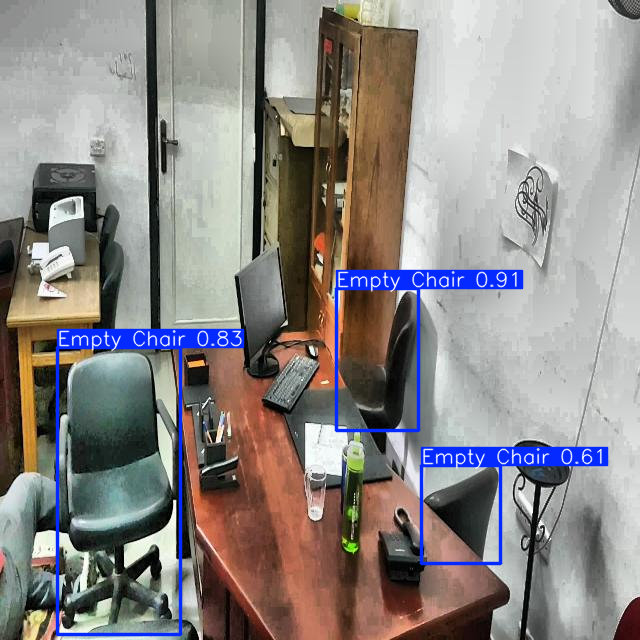

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5380_jpg.rf.a335e3f6989bd077b834eb3bab02630b_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5500_jpg.rf.27e9a39068edc152663b42715eefb253.jpg: 640x640 1 Empty Chair, 1 Idle, 16.5ms
Speed: 2.2ms preprocess, 16.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


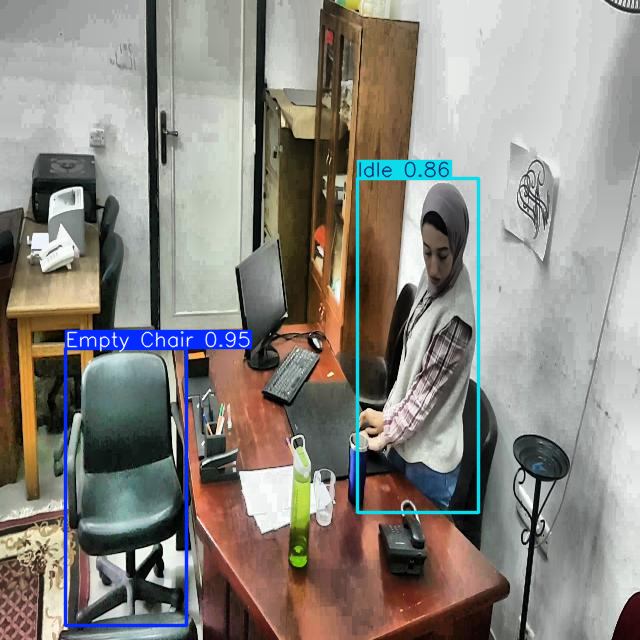

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5500_jpg.rf.27e9a39068edc152663b42715eefb253_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame560_jpg.rf.597b5624537beac1a8dfa5882b76b325.jpg: 640x640 1 Empty Chair, 1 Working, 15.0ms
Speed: 2.0ms preprocess, 15.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


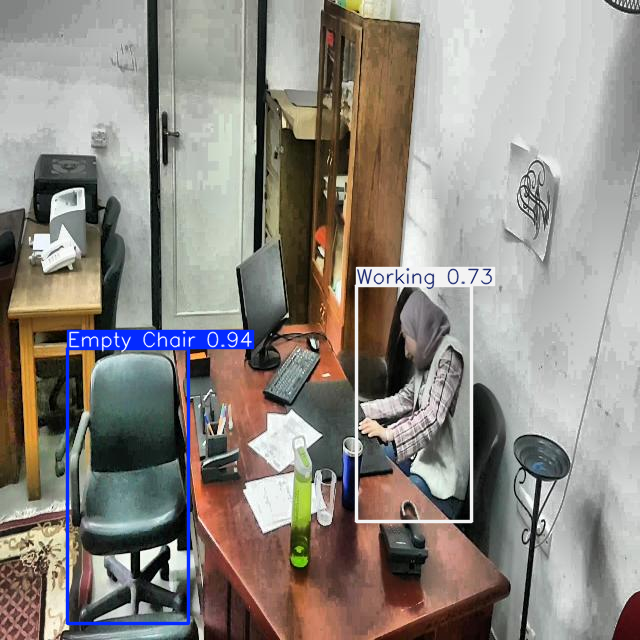

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame560_jpg.rf.597b5624537beac1a8dfa5882b76b325_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5680_jpg.rf.92a2b2bc0ce54444016244f70e76b780.jpg: 640x640 2 Empty Chairs, 1 Idle, 17.9ms
Speed: 2.3ms preprocess, 17.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


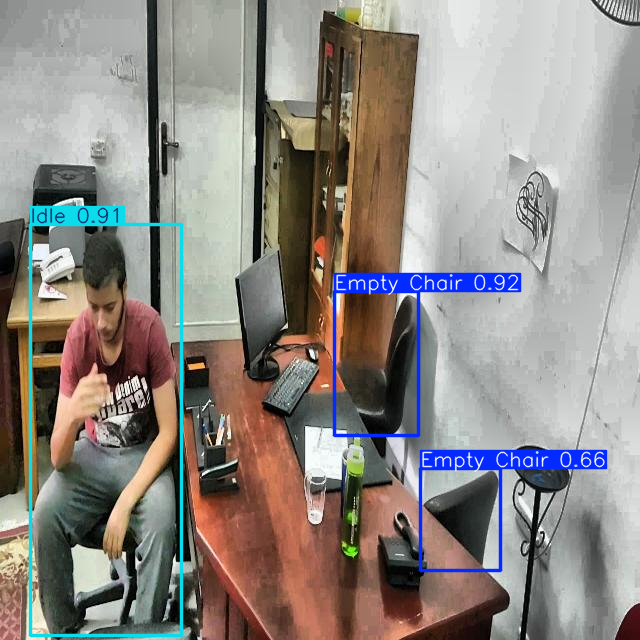

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5680_jpg.rf.92a2b2bc0ce54444016244f70e76b780_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5780_jpg.rf.a3f9f98e0fadfc215f93f26c13daffcc.jpg: 640x640 3 Empty Chairs, 1 Idle, 17.5ms
Speed: 2.3ms preprocess, 17.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


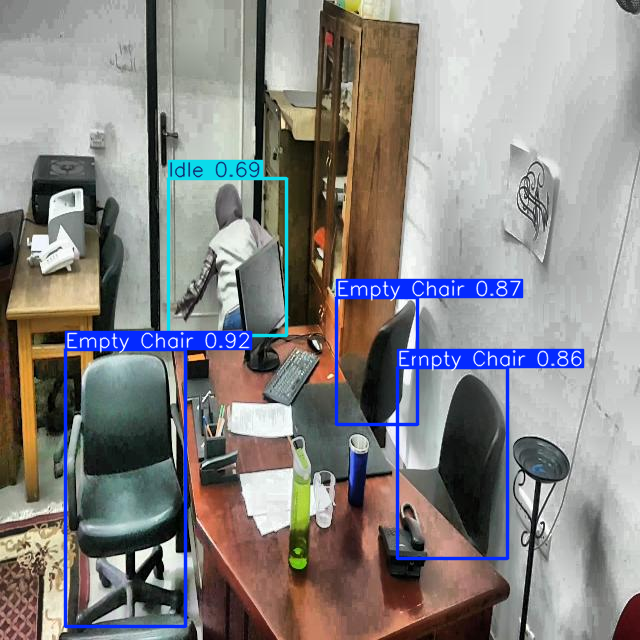

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5780_jpg.rf.a3f9f98e0fadfc215f93f26c13daffcc_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5940_jpg.rf.6b9c9d223a2ab429c79b2bb646be3d2b.jpg: 640x640 3 Empty Chairs, 1 Idle, 17.9ms
Speed: 2.5ms preprocess, 17.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


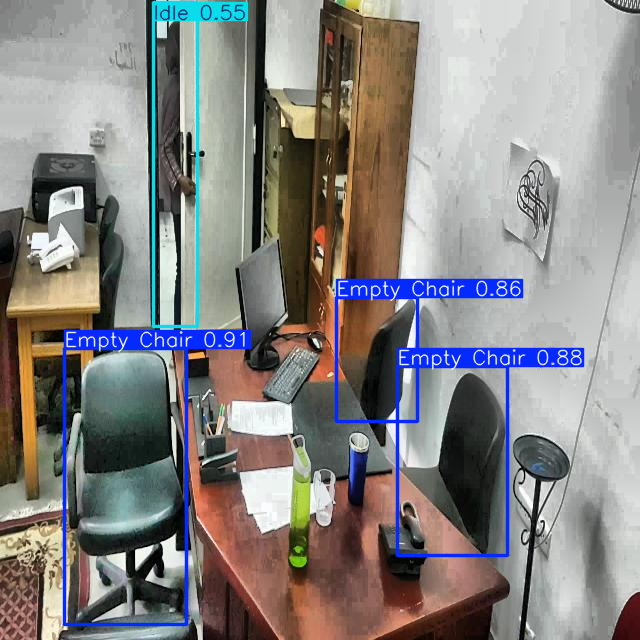

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame5940_jpg.rf.6b9c9d223a2ab429c79b2bb646be3d2b_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame6000_jpg.rf.d5540638125837841af0f6316cfdc22f.jpg: 640x640 3 Empty Chairs, 22.0ms
Speed: 2.3ms preprocess, 22.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


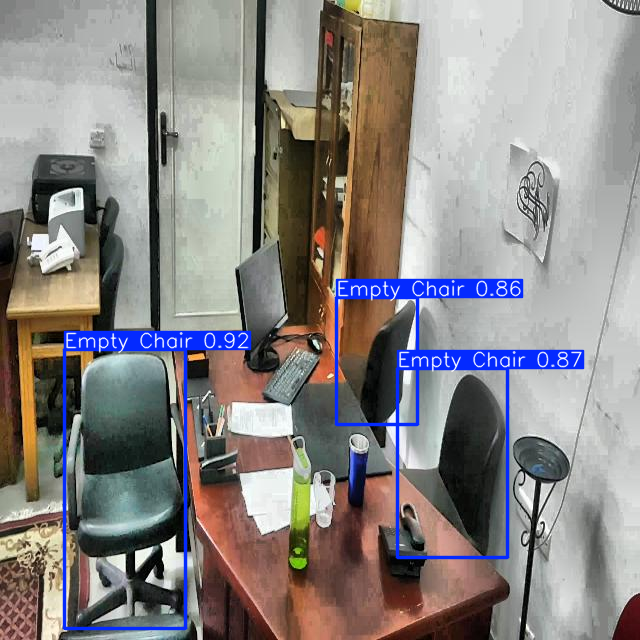

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame6000_jpg.rf.d5540638125837841af0f6316cfdc22f_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame6020_jpg.rf.f3e62f2f1b196b62b186f9ff87e71857.jpg: 640x640 3 Empty Chairs, 21.2ms
Speed: 2.1ms preprocess, 21.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


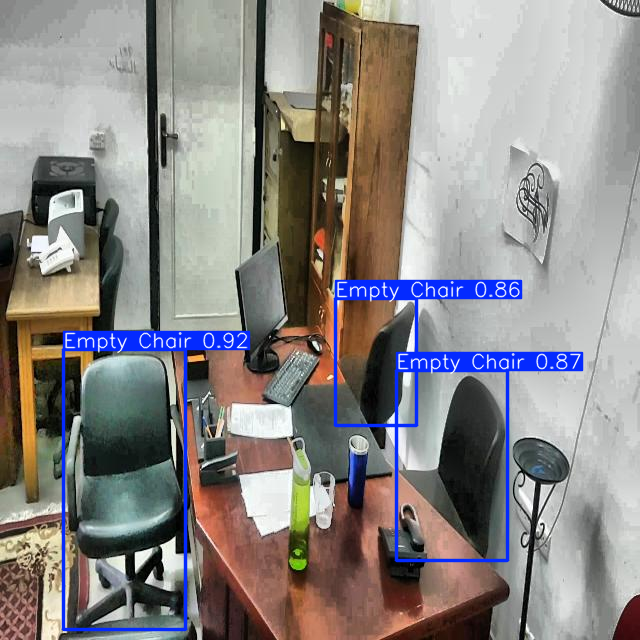

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame6020_jpg.rf.f3e62f2f1b196b62b186f9ff87e71857_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame640_jpg.rf.d7cf36120a32fc05b53a1ab75a07e4f8.jpg: 640x640 1 Empty Chair, 1 Idle, 18.6ms
Speed: 2.1ms preprocess, 18.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


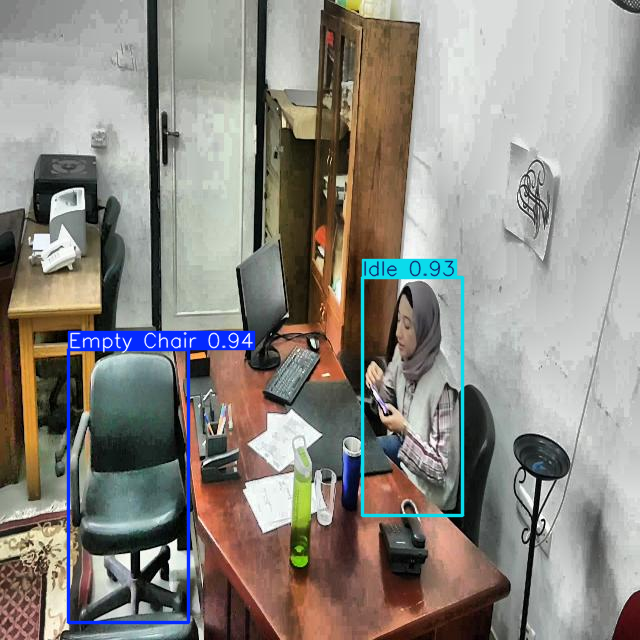

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame640_jpg.rf.d7cf36120a32fc05b53a1ab75a07e4f8_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame680_jpg.rf.05ac18932e02b4518d545c4022aaf0b3.jpg: 640x640 1 Empty Chair, 1 Idle, 12.6ms
Speed: 2.4ms preprocess, 12.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


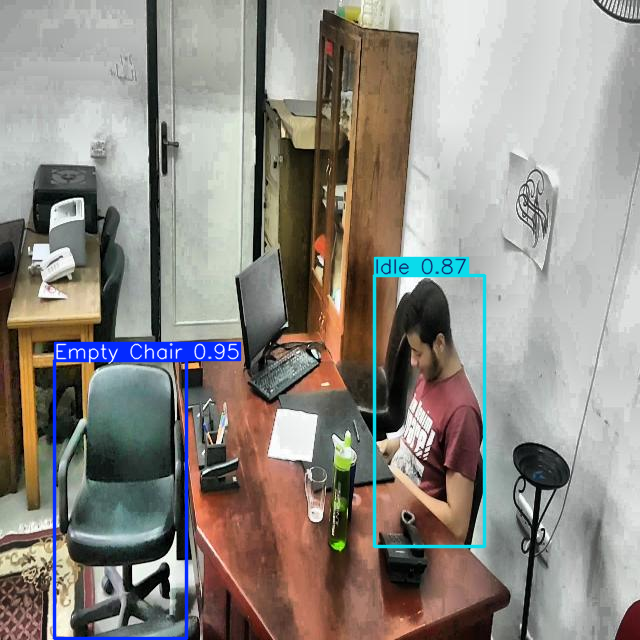

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame680_jpg.rf.05ac18932e02b4518d545c4022aaf0b3_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame880_jpg.rf.22ba37fa5e69ad4289bd2bb9027b35f3.jpg: 640x640 1 Empty Chair, 1 Idle, 25.9ms
Speed: 2.3ms preprocess, 25.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


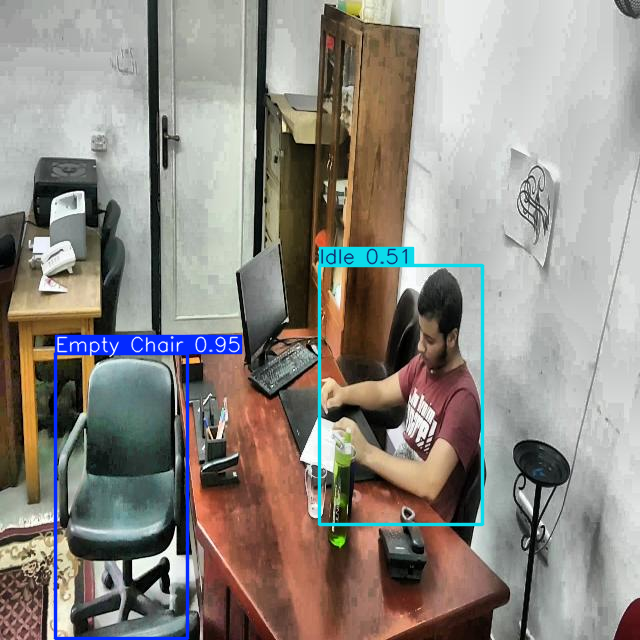

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame880_jpg.rf.22ba37fa5e69ad4289bd2bb9027b35f3_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame960_jpg.rf.bfe094bd41e526c87014c3c8367ecfad.jpg: 640x640 1 Empty Chair, 1 Idle, 25.3ms
Speed: 9.7ms preprocess, 25.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


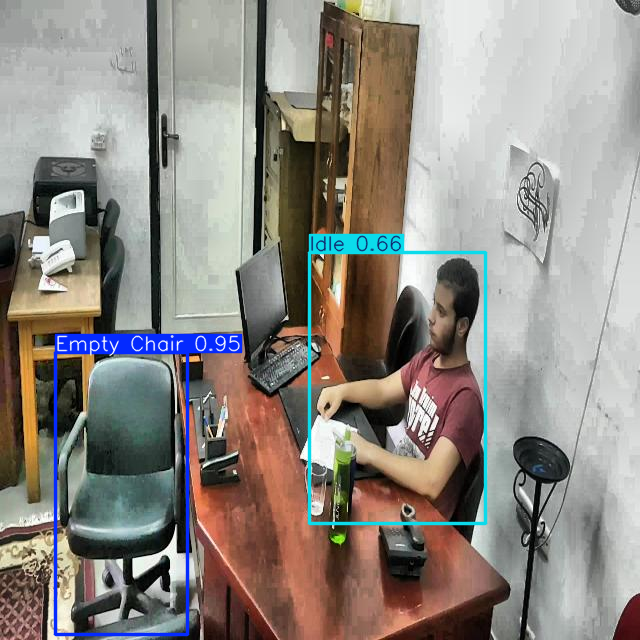

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_10_frame960_jpg.rf.bfe094bd41e526c87014c3c8367ecfad_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_11_frame1000_jpg.rf.55fa44aa25d288bbb81cb0179508698b.jpg: 640x640 1 Empty Chair, 1 Idle, 20.1ms
Speed: 2.2ms preprocess, 20.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


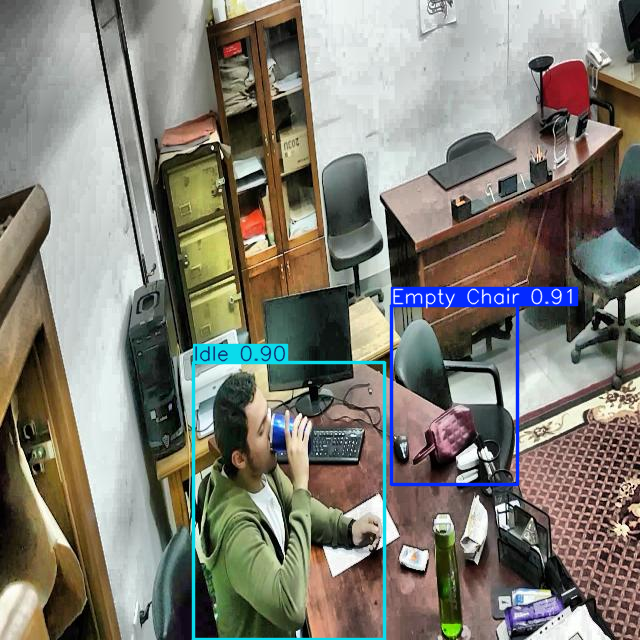

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_11_frame1000_jpg.rf.55fa44aa25d288bbb81cb0179508698b_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_11_frame100_jpg.rf.4061d29b374285249c1230d45bfff4db.jpg: 640x640 1 Empty Chair, 1 Idle, 18.4ms
Speed: 2.1ms preprocess, 18.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


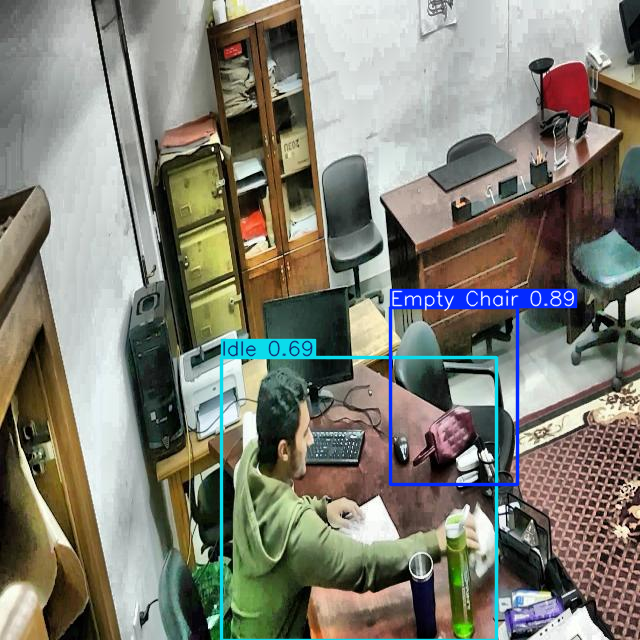

Saved output image: /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_11_frame100_jpg.rf.4061d29b374285249c1230d45bfff4db_output.jpg

image 1/1 /content/drive/MyDrive/Folder/extracted/combine11/test/images/dataset_11_frame1060_jpg.rf.09aea80364820210a5174cf8c6096594.jpg: 640x640 1 Empty Chair, 1 Idle, 16.6ms
Speed: 3.6ms preprocess, 16.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Buffered data was truncated after reaching the output size limit.

In [ ]:
# Path to test image(s)
test_image_path =  '/content/drive/MyDrive/Folder/extracted/combine11/test/images/*.jpg'  # Replace with your folder path
test_images = glob.glob(test_image_path)

# Run predictions and visualize results
for img_path in test_images:
    results = model(img_path)  # Predict on image

    # Each result is a single prediction object
    for result in results:
        result.show()  # Display predictions
        # Save output image
        save_path = img_path.replace(".jpg", "_output.jpg")
        result.save(filename=save_path)
        print(f"Saved output image: {save_path}")

print("Testing complete. Predictions displayed and saved.")

In [ ]:
# Plot Results
for res in results:
    boxes = res.boxes
    for box in boxes:
        print(f"Class: {box.cls}, Confidence: {box.conf}, Coordinates: {box.xyxy}")

Class: tensor([1.], device='cuda:0'), Confidence: tensor([0.7151], device='cuda:0'), Coordinates: tensor([[347.3406, 220.9419, 485.9642, 542.5890]], device='cuda:0')
